# Install & Download

In [ ]:
!git clone https://github.com/Rebeccasun31/AI_Beautifier.git
%cd AI_Beautifier
!pip install -r requirements.txt
!pip install git+https://github.com/openai/CLIP.git

Cloning into 'AI_Beautifier'...
remote: Enumerating objects: 404, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 404 (delta 2), reused 8 (delta 0), pack-reused 390
Receiving objects: 100% (404/404), 67.98 MiB | 11.86 MiB/s, done.
Resolving deltas: 100% (27/27), done.
/content/AI_Beautifier
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.2/299.2 kB 20.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 42.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.9/200.9 kB 15.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 104.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 653.4/653.4 kB 70.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.5/172.5 kB 2

In [ ]:
import gdown
import os

!gdown -O experiments/pretrained_models.zip --id 1-fLpvNk0b0eGJJkvS1i22yuLHacI6JDv
!unzip -d experiments/ experiments/pretrained_models.zip 
os.remove('experiments/pretrained_models.zip')

!gdown -O experiments/weights.zip --id 1Kfqnk_dhbLIbW0B3NaQ1fSUmROpgv6lD 
!unzip -d experiments/ experiments/weights.zip
os.remove('experiments/weights.zip')

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1-fLpvNk0b0eGJJkvS1i22yuLHacI6JDv
To: /content/AI_Beautifier/experiments/pretrained_models.zip
100% 152M/152M [00:03<00:00, 47.4MB/s]
Archive:  experiments/pretrained_models.zip
   creating: experiments/pretrained_models/uformer/
  inflating: experiments/pretrained_models/uformer/net_g_last.pth  
   creating: experiments/pretrained_models/uformer_noreflection/
  inflating: experiments/pretrained_models/uformer_noreflection/net_g_last.pth  
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1Kfqnk_dhbLIbW0B3NaQ

# Upload your picture

In [48]:
from google.colab import files
from shutil import copyfile
import os

os.makedirs('result/input')

files = files.upload()
img_name = list(files.keys())[0]

copyfile(img_name, f'result/input/{img_name}')
os.remove(img_name)
img_path = f'result/input/{img_name}'

IndexError: ignored

In [ ]:
from PIL import Image

img = Image.open(img_path)
img = img.convert('RGB')
img = img.resize((512, 512))
img = img.save(img_path)

# Deflare

In [ ]:
import glob
import torch
import torchvision
import numpy as np
from tqdm import tqdm
from PIL import Image
from basicsr.data.flare7k_dataset import Flare_Image_Loader,RandomGammaCorrection
from basicsr.archs.uformer_arch import Uformer
from basicsr.archs.unet_arch import U_Net
from basicsr.utils.flare_util import blend_light_source, predict_flare_from_6_channel, predict_flare_from_3_channel
from torch.distributions import Normal
import torchvision.transforms as transforms
import os

In [ ]:
def mkdir(path):
	folder = os.path.exists(path)
	if not folder:
		os.makedirs(path)

def demo(img_path, output_path, model_type, output_ch, pretrain_dir):
  if not os.path.exists(output_path):
    os.makedirs(output_path)
  test_path = glob.glob(img_path)
  result_path = output_path

  torch.cuda.empty_cache()
  if model_type == 'Uformer':
    model = Uformer(img_size=512, img_ch=3, output_ch=output_ch).cuda()
    model.load_state_dict(torch.load(pretrain_dir))
  elif model_type == 'U_Net' or model_type == 'U-Net':
    model = U_Net(img_ch=3, output_ch=output_ch).cuda()
    model.load_state_dict(torch.load(pretrain_dir))
  else:
    assert False, "This model is not supported!!"

  to_tensor = transforms.ToTensor()
  resize = transforms.Resize((512,512)) #The output should in the shape of 128X

  for i, image_path in tqdm(enumerate(test_path)):
    deflare_path = result_path + img_name.split('.')[0] + "_deflare.png"

    merge_img = Image.open(image_path).convert("RGB")
    merge_img = resize(to_tensor(merge_img))
    merge_img = merge_img.cuda().unsqueeze(0)

    model.eval()
    with torch.no_grad():
      output_img = model(merge_img)
      #if ch is 6, first three channels are deflare image, others are flare image
      #if ch is 3, unsaturated region of output is the deflare image.
      gamma = torch.Tensor([2.2])
      if output_ch == 6:
          deflare_img, flare_img_predicted, merge_img_predicted = predict_flare_from_6_channel(output_img, gamma)
      elif output_ch == 3:
          flare_mask = torch.zeros_like(merge_img)
          deflare_img, flare_img_predicted = predict_flare_from_3_channel(output_img, flare_mask, output_img, merge_img, merge_img, gamma)
      else:
          assert False, "This output_ch is not supported!!"

      torchvision.utils.save_image(deflare_img, deflare_path)

  return deflare_path

In [ ]:
model_type = 'Uformer'
result_path = 'result/deflare_output/'
pretrain_dir = 'experiments/pretrained_models/uformer/net_g_last.pth'
output_ch = 6

img_path = demo(img_path, result_path, model_type, output_ch, pretrain_dir)

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
0it [00:00, ?it/s]/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.

# Inpainting

In [ ]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
import numpy as np
from models.resnet import ResNet
from models.unet import UNet
from models.skip import skip
import PIL
import torch
import torch.optim
import torchvision

from utils.inpainting_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark = True
dtype = torch.cuda.FloatTensor

PLOT = True
imsize = -1
dim_div_by = 64

def mkdir(path):
	folder = os.path.exists(path)
	if not folder:
		os.makedirs(path)

mask_path = 'result/inpainting_output/'
if not os.path.exists(mask_path):
    os.makedirs(mask_path)
mask_path += img_name.split('.')[0] + "_mask.png"

## 1. Automatically generate the mask

In [42]:
import torch
from models.clipseg import CLIPDensePredT
from PIL import Image
from torchvision import transforms
from matplotlib import pyplot as plt

In [43]:
# load model
model = CLIPDensePredT(version='ViT-B/16', reduce_dim=64)
model.eval();

# non-strict, because we only stored decoder weights (not CLIP weights)
model.load_state_dict(torch.load('experiments/clipseg_weights/rd64-uni.pth', map_location=torch.device('cpu')), strict=False);

# load and normalize image
img = Image.open(img_path)
img = img.convert('RGB')

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    transforms.Resize((512, 512)),
])
img_t = transform(img).unsqueeze(0)

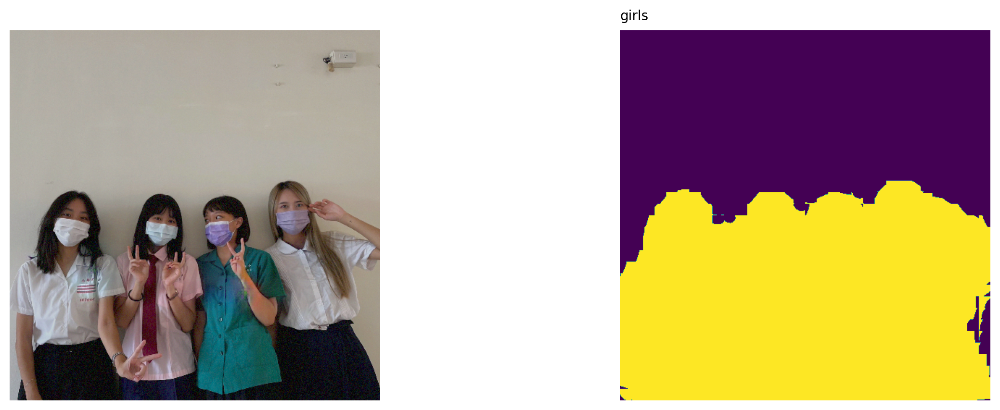

In [44]:
prompts = 'girls' #@param {type:"string"}

# predict
with torch.no_grad():
    preds = model(img_t.repeat(1,1,1,1), prompts)[0]

cutoff = preds.min() + 0.65 * (preds.max() - preds.min())
mask = torch.where(preds > cutoff, 1.0, 0.0)

# visualize prediction
_, ax = plt.subplots(1, 2)
[a.axis('off') for a in ax.flatten()]
ax[0].imshow(img)
ax[1].imshow(torch.sigmoid(mask[0][0]))
ax[1].text(0, -15, prompts)
plt.show()

(512, 512, 3)


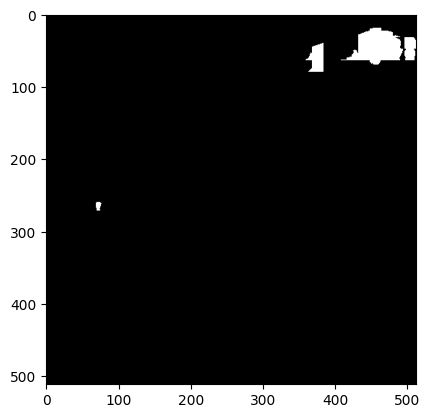

In [ ]:
import numpy as np
import cv2

mask = mask.squeeze(0)
mask = mask.permute(1, 2, 0).numpy()
mask = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
print(mask.shape)

plt.imshow(mask)
plt.show()
plt.imsave(mask_path, mask, cmap='gray')

## 2. Manually draw the mask



In [45]:
import base64
import os
import shutil
import matplotlib.pyplot as plt
from IPython.display import HTML, Image
from google.colab.output import eval_js
from base64 import b64decode
from PIL import Image

canvas_html = """
<style>
.button {
  background-color: #4CAF50;
  border: none;
  color: white;
  padding: 15px 32px;
  text-align: center;
  text-decoration: none;
  display: inline-block;
  font-size: 16px;
  margin: 4px 2px;
  cursor: pointer;
}
</style>
<canvas1 width=%d height=%d>
</canvas1>
<canvas width=%d height=%d>
</canvas>

<button class="button">Finish</button>
<script>
var canvas = document.querySelector('canvas')
var ctx = canvas.getContext('2d')

var canvas1 = document.querySelector('canvas1')
var ctx1 = canvas.getContext('2d')


ctx.strokeStyle = 'red';

var img = new Image();
img.src = "data:image/%s;charset=utf-8;base64,%s";
console.log(img)
img.onload = function() {
  ctx1.drawImage(img, 0, 0);
};
img.crossOrigin = 'Anonymous';

ctx.clearRect(0, 0, canvas.width, canvas.height);

ctx.lineWidth = %d
var button = document.querySelector('button')
var mouse = {x: 0, y: 0}

canvas.addEventListener('mousemove', function(e) {
  mouse.x = e.pageX - this.offsetLeft
  mouse.y = e.pageY - this.offsetTop
})
canvas.onmousedown = ()=>{
  ctx.beginPath()
  ctx.moveTo(mouse.x, mouse.y)
  canvas.addEventListener('mousemove', onPaint)
}
canvas.onmouseup = ()=>{
  canvas.removeEventListener('mousemove', onPaint)
}
var onPaint = ()=>{
  ctx.lineTo(mouse.x, mouse.y)
  ctx.stroke()
}

var data = new Promise(resolve=>{
  button.onclick = ()=>{
    resolve(canvas.toDataURL('image/png'))
  }
})
</script>
"""

def draw(imgm, filename='drawing.png', w=512, h=512, line_width=0.5):
  display(HTML(canvas_html % (w, h, w,h, filename.split('.')[-1], imgm, line_width)))
  data = eval_js('data')
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)

Will use result/deflare_output/creditors_flare_deflare.png for inpainting


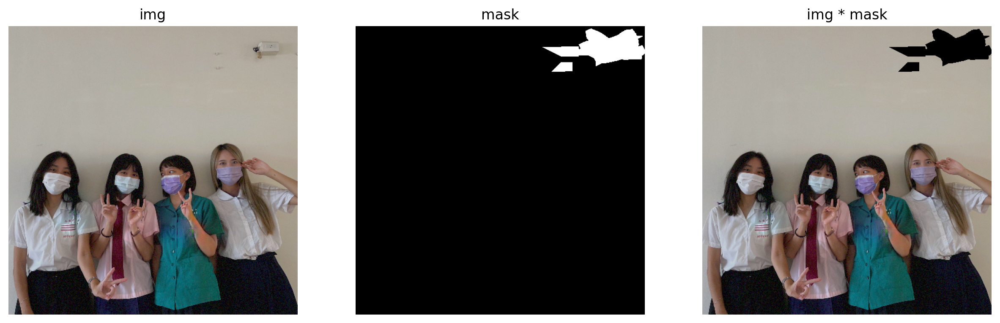

In [46]:
image64 = base64.b64encode(open(img_path, 'rb').read())
image64 = image64.decode('utf-8')

print(f'Will use {img_path} for inpainting')
img = np.array(plt.imread(img_path)[:,:,:3])

draw(image64, filename=mask_path, w=img.shape[1], h=img.shape[0], line_width=0.03*img.shape[1])
#@title Show a masked image and save a mask
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (15,5)
plt.rcParams['figure.dpi'] = 200
plt.subplot(131)
img = np.array(plt.imread(img_path)[:,:,:3])
plt.imshow(img)
plt.axis('off')
plt.title('img')

plt.subplot(132)
with_mask = np.array(plt.imread(mask_path)[:,:,:3])
mask = (with_mask[:,:,0]==1)*(with_mask[:,:,1]==0)*(with_mask[:,:,2]==0)
plt.imshow(mask, cmap='gray')
plt.axis('off')
plt.title('mask')
plt.imsave(mask_path, mask, cmap='gray')

plt.subplot(133)
img = np.array((1-mask.reshape(mask.shape[0], mask.shape[1], -1))*img)
_=plt.imshow(img)
_=plt.axis('off')
_=plt.title('img * mask')
plt.show()

## Load mask

In [ ]:
print(img_path, mask_path)

result/deflare_output/creditors_flare_deflare.png result/inpainting_output/creditors_flare_mask.png


In [ ]:
def get_image_rgb(path, imsize=-1):
  img = PIL.Image.open(path)
  img = img.convert('RGB')
 
  if isinstance(imsize, int):
      imsize = (imsize, imsize)

  if imsize[0]!= -1 and img.size != imsize:
      if imsize[0] > img.size[0]:
          img = img.resize(imsize, PIL.Image.BICUBIC)
      else:
          img = img.resize(imsize, PIL.Image.ANTIALIAS)

  img_np = pil_to_np(img)
  return img, img_np

In [ ]:
img_pil, img_np = get_image_rgb(img_path)
img_mask_pil, img_mask_np = get_image_rgb(mask_path)

img_mask_np = np.array(1-img_mask_np.reshape(img_mask_np.shape[0], img_mask_np.shape[1], -1))

### Visualize

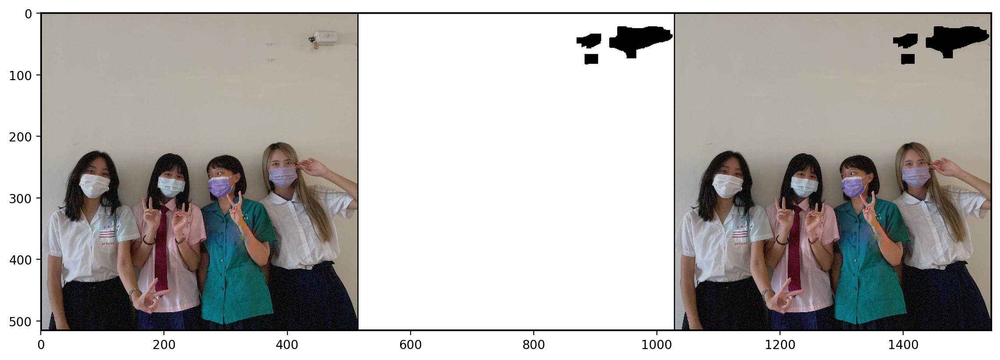

In [35]:
plot_image_grid([img_np, img_mask_np, img_mask_np*img_np], 3, 11);

## Setup

In [36]:
NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

pad = 'reflection' # 'zero'
OPT_OVER = 'net'
OPTIMIZER = 'adam'

INPUT = 'noise'
input_depth = 32
LR = 0.01 
num_iter = 3000
param_noise = False
show_every = 50
figsize = 3
reg_noise_std = 0.03

net = skip(input_depth, img_np.shape[0], 
            num_channels_down = [128] * 5,
            num_channels_up =   [128] * 5,
            num_channels_skip =    [128] * 5,  
            filter_size_up = 3, filter_size_down = 3, 
            upsample_mode='nearest', filter_skip_size=1,
            need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)

net = net.type(dtype)
net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)

In [37]:
# Compute number of parameters
s  = sum(np.prod(list(p.size())) for p in net.parameters())
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_var = np_to_torch(img_np).type(dtype)
mask_var = np_to_torch(img_mask_np).type(dtype)

Number of params: 3002627


## Main loop

Starting optimization with ADAM


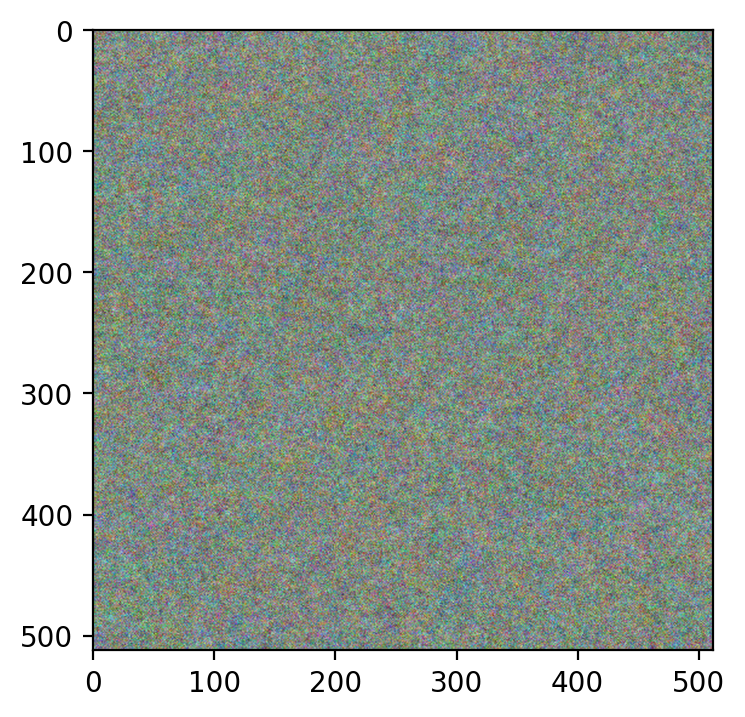

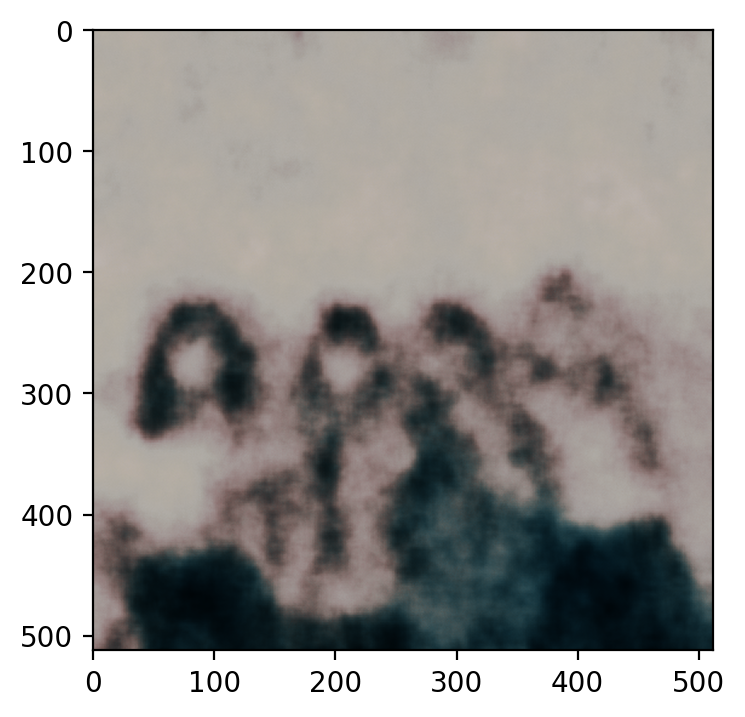

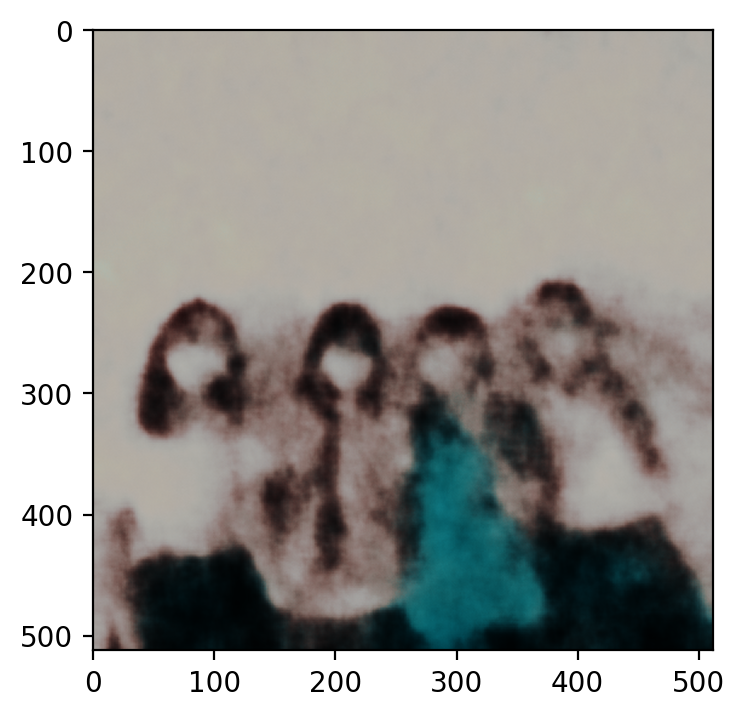

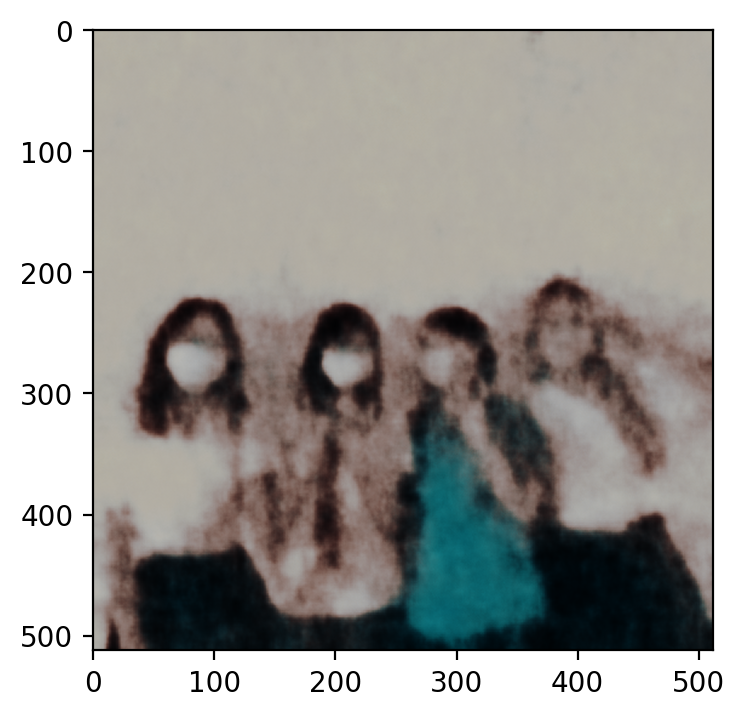

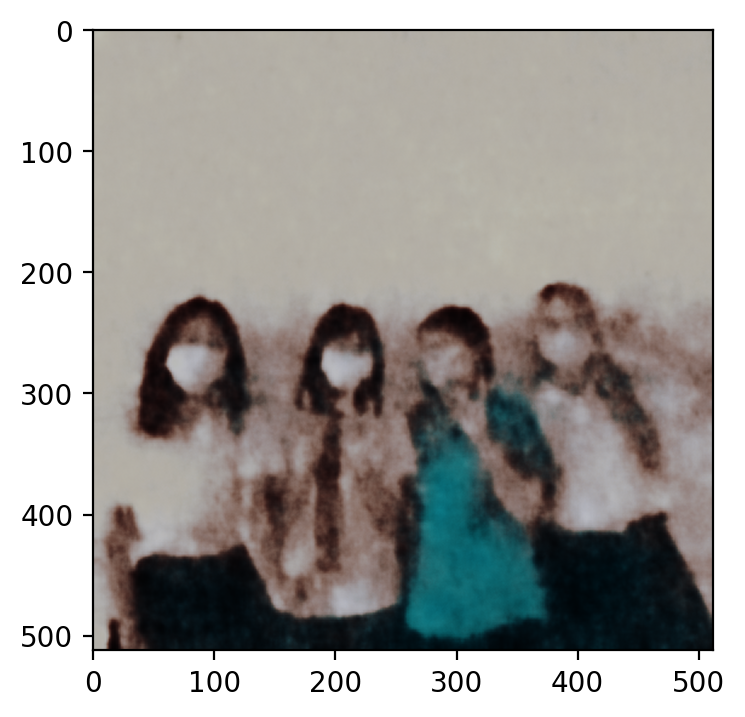

...

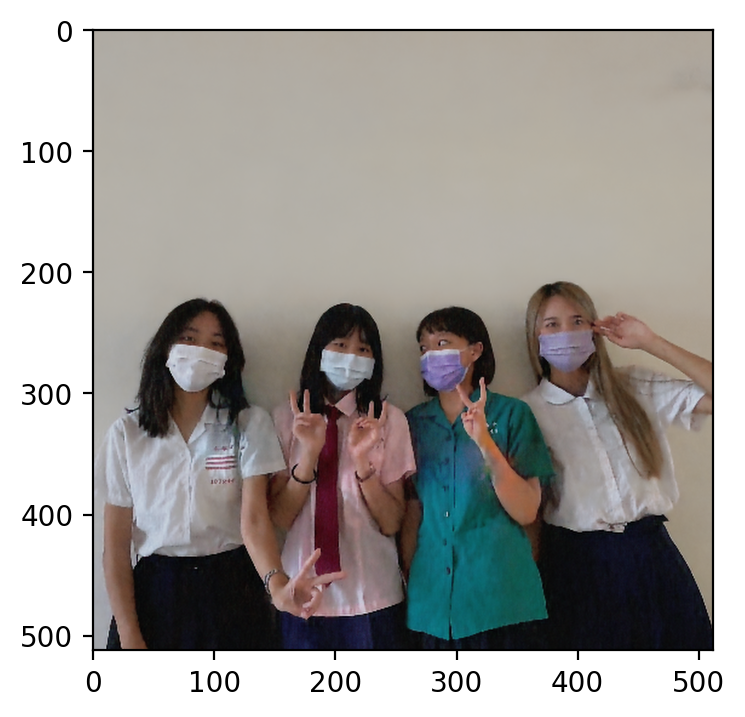

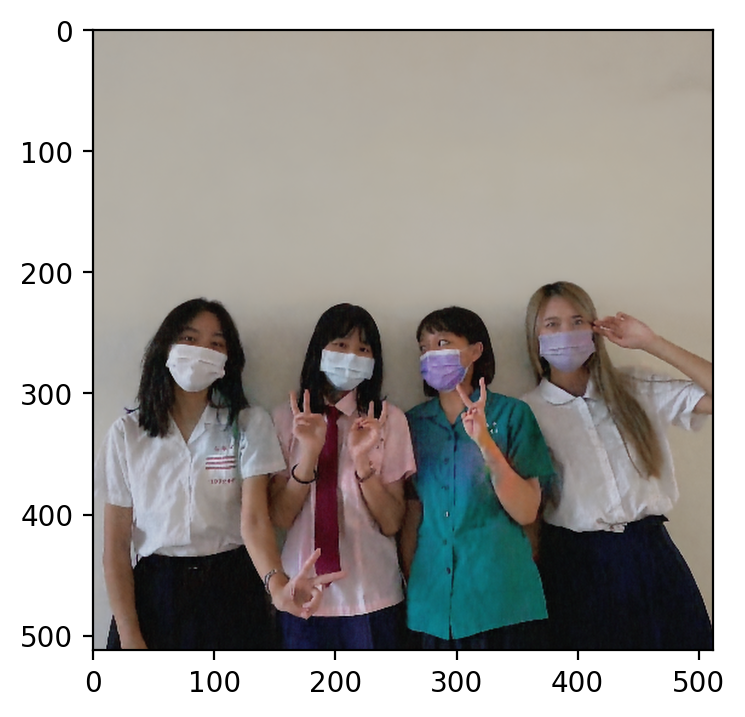

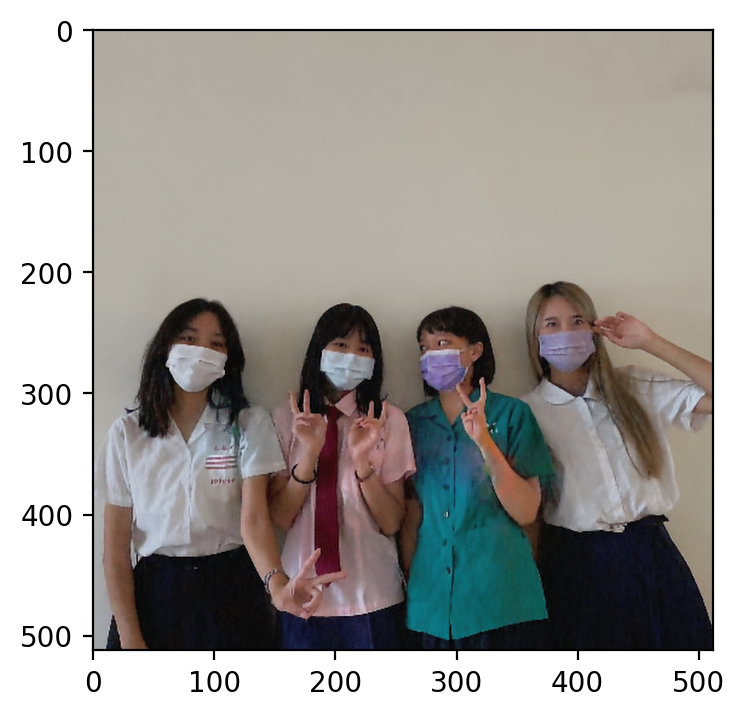

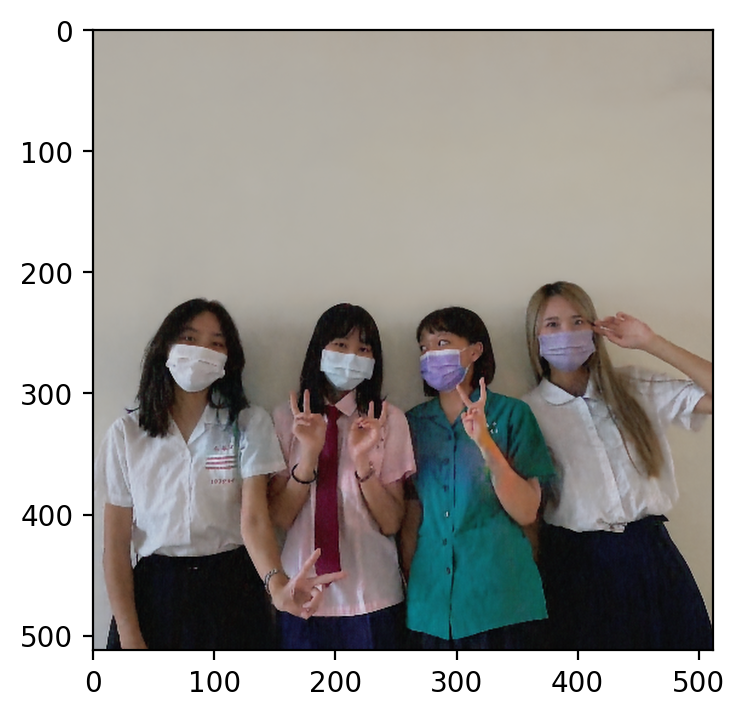

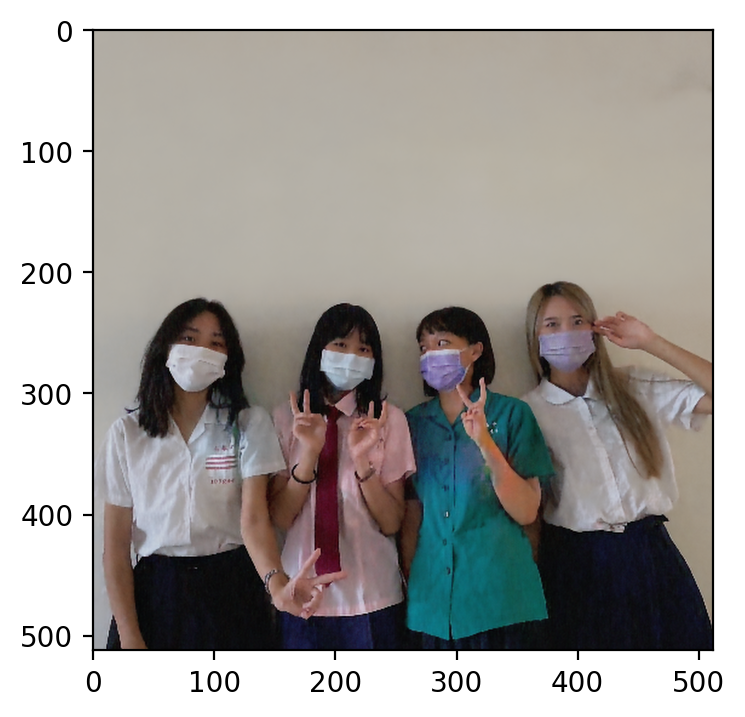

In [38]:
i = 0
def closure():
    
    global i
    
    if param_noise:
        for n in [x for x in net.parameters() if len(x.size()) == 4]:
            n = n + n.detach().clone().normal_() * n.std() / 50
    
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
        
        
    out = net(net_input)
    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()
        
    print ('Iteration %05d    Loss %f' % (i, total_loss.item()), '\r', end='')
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
        
    i += 1

    return total_loss


net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

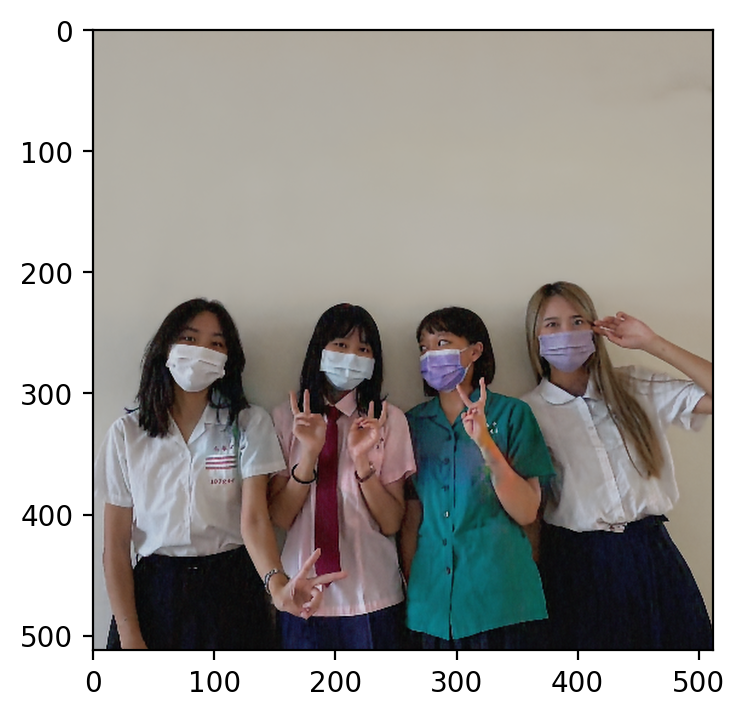

In [39]:
output_np = torch_to_np(net(net_input))
plot_image_grid([output_np], factor=figsize);

In [40]:
output_path = 'result/inpainting_output/' + img_name.split('.')[0] + "_output.png"
torchvision.utils.save_image(net(net_input), output_path)

## Evaluate

In [41]:
from skimage.metrics import peak_signal_noise_ratio as compare_psnr
from skimage.metrics import structural_similarity as compare_ssim

from torchvision.transforms import ToTensor
import numpy as np
from glob import glob
import lpips
from tqdm import tqdm

import warnings
warnings.filterwarnings("ignore")

def compare_lpips(img1, img2, loss_fn_alex):
    to_tensor=ToTensor()
    img1_tensor = to_tensor(img1).unsqueeze(0)
    img2_tensor = to_tensor(img2).unsqueeze(0)
    output_lpips = loss_fn_alex(img1_tensor, img2_tensor)
    return output_lpips.detach().numpy()[0,0,0,0]

def calculate_metrics(img_path, output_path):
    loss_fn_alex = lpips.LPIPS(net='alex')

    ssim, psnr, lpips_val = 0, 0, 0

    img_input_pil, _ = get_image_rgb(img_path, imsize)
    img_gt_pil, _ = get_image_rgb(output_path, img_input_pil.size)

    img_input_np = np.array(img_input_pil)
    img_gt_np = np.array(img_gt_pil)

    ssim = compare_ssim(img_gt_np, img_input_np, multichannel=True, channel_axis=3)
    psnr = compare_psnr(img_gt_np, img_input_np, data_range=255)
    lpips_val = compare_lpips(img_gt_np, img_input_np, loss_fn_alex)

    print(f"psnr: {psnr}, ssim: {ssim}, lpips: {lpips_val}")

calculate_metrics(img_path, output_path)

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:11<00:00, 21.3MB/s]


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/alex.pth
psnr: 32.03963596748282, ssim: 0.8625180863194079, lpips: 0.07105142623186111
